In [1]:
import pandas as pd
import datetime
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import Point, LineString, MultiLineString
import geopandas as gpd
from folium.plugins import MarkerCluster,FeatureGroupSubGroup,Fullscreen,FastMarkerCluster,TimestampedGeoJson
from folium import DivIcon
from ipyleaflet import basemaps, basemap_to_tiles, Marker, Map, Popup
from folium.map import Layer,FeatureGroup
import folium
from branca.element import Template, MacroElement

import html
import re

## Read in Data

In [2]:
#Data Source: https://catalog.data.gov/dataset/global-landslide-catalog-export

landslides = pd.read_csv('./data/Global_Landslide_Catalog_Export.csv')
landslides.shape

(11033, 31)

In [3]:
## Identify columns we won't be using and drop them from our dataframe

cols_to_drop = ['event_time','submitted_date','created_date','last_edited_date','event_import_id','event_import_source']
landslides.drop(columns=cols_to_drop,inplace = True)

In [4]:
## Convert event_date column to datetime
landslides['event_datetime'] = pd.to_datetime(landslides['event_date'])

In [5]:
landslides['event_day'] = landslides['event_datetime'].apply(lambda x: x.date())

In [6]:
## Extract year from event_datetime
landslides['event_year'] = [date.year for date in landslides['event_datetime']]

In [7]:
landslides.shape

(11033, 28)

In [8]:
## Check the one row with a missing value for landslide_category
landslides[landslides['landslide_category'].isna()]

,source_name,source_link,event_id,event_date,event_title,event_description,location_description,location_accuracy,landslide_category,landslide_trigger,...,country_code,admin_division_name,admin_division_population,gazeteer_closest_point,gazeteer_distance,longitude,latitude,event_datetime,event_day,event_year
10102,Times of India,http://timesofindia.indiatimes.com/city/dehrad...,10066,09/11/2016 12:55:00 PM,"Landslide kills Army colonel, wife on Badrinat...",A planned visit to Badrinath turned fatal for ...,"Badrinath Highway, between Pandukeshwar and Jo...",5km,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,79.569767,30.59661,2016-09-11 12:55:00,2016-09-11,2016


In [9]:
## Fill the landslide_category and landslide_trigger columns for the above row with 'landslide' and 'rain' respectively

landslides.loc[landslides['landslide_category'].isna(),['landslide_category','landslide_trigger']] = 'landslide','rain'

In [10]:
## Check to see that it worked

landslides.loc[10102,['landslide_category','landslide_trigger']]

landslide_category    landslide
landslide_trigger          rain
Name: 10102, dtype: object

In [11]:
## Make dummy columns for landslide_category

ls_cat = pd.get_dummies(landslides['landslide_category'])
ls_cat.head()

,complex,creep,debris_flow,earth_flow,lahar,landslide,mudslide,other,riverbank_collapse,rock_fall,snow_avalanche,topple,translational_slide,unknown
0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,1,0,0,0,0,0,0,0
2,0,0,0,0,0,1,0,0,0,0,0,0,0,0
3,0,0,0,0,0,1,0,0,0,0,0,0,0,0
4,0,0,0,0,0,1,0,0,0,0,0,0,0,0


In [12]:
## Concatenate our dummy columns with our original dataframe

landslides_df = pd.concat([landslides,ls_cat], axis = 1)

In [13]:
## Convert our dataframe into a GeoPandas dataframe by using longitude and latitude to create point geometries

## Create point geometries column
geom = [Point(xy) for xy in zip(landslides_df['longitude'],landslides_df['latitude'])]

## Set the coordinate reference system we'll be using. 
## EPSG:4326 is the CRS for the WGS1984 datum (standard for maps of the whole world)
crs = {'init':'epsg:4326'}
landslides_gpd = gpd.GeoDataFrame(landslides_df,crs = crs,geometry = geom)

landslides_gpd.head()

,source_name,source_link,event_id,event_date,event_title,event_description,location_description,location_accuracy,landslide_category,landslide_trigger,...,landslide,mudslide,other,riverbank_collapse,rock_fall,snow_avalanche,topple,translational_slide,unknown,geometry
0,AGU,https://blogs.agu.org/landslideblog/2008/10/14...,684,08/01/2008 12:00:00 AM,"Sigou Village, Loufan County, Shanxi Province","occurred early in morning, 11 villagers buried...","Sigou Village, Loufan County, Shanxi Province",unknown,landslide,rain,...,1,0,0,0,0,0,0,0,0,POINT (107.45 32.5625)
1,Oregonian,http://www.oregonlive.com/news/index.ssf/2009/...,956,01/02/2009 02:00:00 AM,"Lake Oswego, Oregon",Hours of heavy rain are to blame for an overni...,"Lake Oswego, Oregon",5km,mudslide,downpour,...,0,1,0,0,0,0,0,0,0,POINT (-122.663 45.42)
2,CBS News,https://www.cbsnews.com/news/dozens-missing-af...,973,01/19/2007 12:00:00 AM,"San Ramon district, 195 miles northeast of the...",(CBS/AP) At least 10 people died and as many a...,"San Ramon district, 195 miles northeast of the...",10km,landslide,downpour,...,1,0,0,0,0,0,0,0,0,POINT (-75.3587 -11.1295)
3,Reuters,https://in.reuters.com/article/idINIndia-41450...,1067,07/31/2009 12:00:00 AM,Dailekh district,"One person was killed in Dailekh district, pol...",Dailekh district,unknown,landslide,monsoon,...,1,0,0,0,0,0,0,0,0,POINT (81.708 28.8378)
4,The Freeman,http://www.philstar.com/cebu-news/621414/lands...,2603,10/16/2010 12:00:00 PM,sitio Bakilid in barangay Lahug,Another landslide in sitio Bakilid in barangay...,sitio Bakilid in barangay Lahug,5km,landslide,tropical_cyclone,...,1,0,0,0,0,0,0,0,0,POINT (123.8978 10.3336)


In [14]:
## Check shape of our geopandas dataframe
landslides_gpd.shape

(11033, 43)

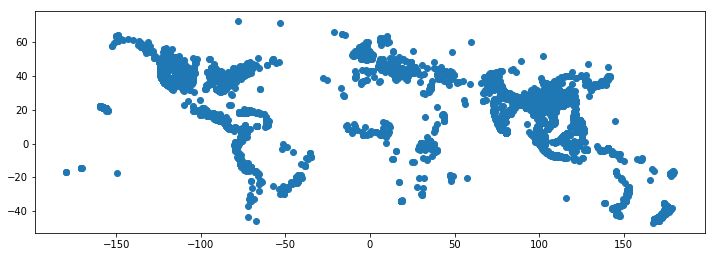

In [15]:
## Quick plot of our data
landslides_gpd.plot(figsize = (12,12))

### Data Cleaning for HTML Rendering

In [16]:
## Columns we will be using in our map for popup info

map_cols = ['event_title','event_datetime','landslide_trigger','landslide_category','country_name','fatality_count',
            'source_link','location_description','event_description','admin_division_name', 'photo_link', 'storm_name']

In [17]:
## Go through the columns we'll be using for the popups and remove or replace all characters that would interfere with the html
## Just a bunch of methods I'm using to clean the text (I figured this out through trial & error & lots of googling)

for col in map_cols:
    landslides_gpd[col] = [html.escape(str(row)).replace('`','').strip().replace('nan','') for row in landslides_gpd[col]]

In [18]:
## Fill NAs with empty strings so we don't have NAs messing up our map
## This may cause an error, if so, comment it out
landslides_gpd.fillna('', inplace = True)

In [19]:
## Color dictionary for landslide categories
color_dict = {
    'complex':'firebrick',
    'creep':'salmon',
    'debris_flow':'darkcyan',
    'earth_flow':'coral',
    'lahar':'darkorange',
    'landslide':'crimson',
    'mudslide':'sienna',
    'other':'slategrey',
    'riverbank_collapse':'mediumslateblue',
    'rock_fall':'gold',
    'snow_avalanche':'powderblue',
    'topple':'darkgoldenrod',
    'translational_slide':'goldenrod',
    'unknown':'dimgrey'
}

color_dict_rgb = {
    'complex':(178,34,34),
    'creep': (255, 153, 153),
    'debris_flow':(0,139,139),
    'earth_flow': (255,92,92),
    'lahar':(255, 140, 0),
    'landslide':(220, 20, 60),
    'mudslide':(220,97,2),
    'other':(123, 104, 238),
    'riverbank_collapse':(123, 104, 238),
    'rock_fall':(255,197,1),
    'snow_avalanche':(153,204,255),
    'topple':(204,153,0),
    'translational_slide':(255,179,0),
    'unknown':(165,165,165)
}

## GeoJSON Version of Map with Time Slider

In [20]:
landslides_gpd['event_year'].value_counts()

2010    1536
2015    1341
2011    1324
2017    1255
2016    1183
2013    1132
2014    1035
2012     794
2008     553
2009     423
2007     412
2006      13
1998      12
1997      10
2003       2
2005       2
1996       2
2004       1
1988       1
1995       1
1993       1
Name: event_year, dtype: int64

In [21]:
## For some reason there's currently an issue in Folium when implementing a timeslider
## with years prior to 2000. Given that only 29 events in our dataset are prior to 2004
## we'll drop all events prior to 2004 to avoid the timeslider issue.
map_gpd = landslides_gpd[landslides_gpd['event_year'] >= 2004].drop(columns = ['event_date'])

In [22]:
map_gpd.sort_values(by = 'event_day', inplace = True)

In [23]:
map_gpd.reset_index(drop = True, inplace = True)

In [24]:
## Javascript doesn't like datetime objects
map_gpd['event_datetime'] = map_gpd['event_datetime'].astype(str)
map_gpd['event_day'] = map_gpd['event_day'].astype(str)

In [50]:
def make_geojson_features(df):
    features = []
    for feat in df.iterfeatures():
        
        color_rgb = color_dict_rgb[feat['properties']['landslide_category']]
        
        html = """<svg height="100" width="100">
               <circle cx="50" cy="50" r="40" stroke={col} stroke-width="3" fill={col} />
               </svg>"""
        div = html.format(col = f"RGB{color_rgb}")
            
        div_icon = folium.features.DivIcon(html=div)
        
        feat['properties']['time'] = pd.to_datetime(feat['properties']['event_day']).date().__str__()
        feat['properties']['style'] = {'color':f'RGB{color_rgb}'}
        feat['properties']['icon'] = 'circle'
        feat['properties']['iconstyle'] = {
            'color':f'RGB{color_rgb}',
            'fillColor': f'RGB{color_rgb}',
            'fillOpacity': 0.6,
            'stroke': 'true',
            'radius': 10,
            'weight': 3
                }
        html = """
            <h4>{title}</h4><br>
            <b>Date:</b> {event_time}<br>
            <b>Country:</b> {country}<br>
            <b>Location Description:</b> {location_desc}<br>
            <b>Event Type:</b> {event_type}<br>
            <b>Event Description:</b> {event_desc}<br>
            <b>Fatality Count:</b> {fatality_count}<br>
            <b>Photo URL:</b> <a href=" {photo_url} "target="_blank"> Click here for a photo (if available) </a><br>
            <b>URL:</b> <a href=" {url} "target="_blank"> Click here for more info </a>
        """
        popup_contents = html.format(title = feat['properties']['event_title'],
                                     event_time = feat['properties']['event_day'],
                                     country = feat['properties']['country_name'],
                                     event_type = feat['properties']['landslide_category'],
                                     event_desc = feat['properties']['event_description'],
                                     location_desc = feat['properties']['location_description'],
                                     fatality_count = feat['properties']['fatality_count'],
                                     photo_url = feat['properties']['photo_link'] if feat['properties']['photo_link'].strip() != '' else 'No photo available',
                                     url = feat['properties']['source_link'])
        feat['properties']['popup'] = popup_contents
        features.append(feat)
    
    return(features)

In [51]:
## ORIGINAL
def make_landslide_map(features):
    landslide_map = folium.Map(location = [39.50, -98.35],
                              zoom_start = 2,
                              tiles = 'Stamen Toner',
                              control_scale=True, 
                              prefer_canvas = True)

    Fullscreen(
        title='Full Screen Mode',
        title_cancel='Exit Full Screen',
        force_separate_button=True,
    ).add_to(landslide_map)
    
    gj = TimestampedGeoJson(
        {'type':'FeatureCollection',
         'features': features},
        period='P1M',
        add_last_point = True,
        auto_play = False,
        loop = False,
        loop_button= True,
        time_slider_drag_update=True,
        date_options = 'YYYY-MM-DD',
        duration= 'P1Y'
    )
    
    gj.add_to(landslide_map)

    template = """
    {% macro html(this, kwargs) %}

    <!doctype html>
    <html lang="en">
    <head>
      <meta charset="utf-8">
      <meta name="viewport" content="width=device-width, initial-scale=1">
      <title>jQuery UI Draggable - Default functionality</title>
      <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

      <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
      <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>

      <script>
      $( function() {
        $( "#maplegend" ).draggable({
                        start: function (event, ui) {
                            $(this).css({
                                right: "auto",
                                top: "auto",
                                bottom: "auto"
                            });
                        }
                    });
    });

      </script>
    </head>
    <body>


    <div id='maplegend' class='maplegend' 
        style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
         border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>


    <div class='legend-title'>Legend</div>
    <div class='legend-scale'>
      <ul class='legend-labels'>
        <li><span style='background:firebrick;opacity:0.7;'></span>Complex</li>
        <li><span style='background:salmon;opacity:0.7;'></span>Creep</li>
        <li><span style='background:darkcyan;opacity:0.7;'></span>Debris Flow</li>
        <li><span style='background:coral;opacity:0.7;'></span>Earth Flow</li>
        <li><span style='background:darkorange;opacity:0.7;'></span>Lahar</li>
        <li><span style='background:crimson;opacity:0.7;'></span>Landslide</li>
        <li><span style='background:sienna;opacity:0.7;'></span>Mudslide</li>
        <li><span style='background:slategrey;opacity:0.7;'></span>Other</li>
        <li><span style='background:mediumslateblue;opacity:0.7;'></span>Riverbank Collapse</li>
        <li><span style='background:gold;opacity:0.7;'></span>Rock Fall</li>
        <li><span style='background:powderblue;opacity:0.7;'></span>Snow Avalanche</li>
        <li><span style='background:darkgoldenrod;opacity:0.7;'></span>Topple</li>
        <li><span style='background:goldenrod;opacity:0.7;'></span>Translational Slide</li>
        <li><span style='background:dimgrey;opacity:0.7;'></span>Unknown</li>
      </ul>
    </div>
    </div>

    </body>
    </html>

    <style type='text/css'>
      .maplegend .legend-title {
        text-align: left;
        margin-bottom: 5px;
        font-weight: bold;
        font-size: 90%;
        }
      .maplegend .legend-scale ul {
        margin: 0;
        margin-bottom: 5px;
        padding: 0;
        float: left;
        list-style: none;
        }
      .maplegend .legend-scale ul li {
        font-size: 80%;
        list-style: none;
        margin-left: 0;
        line-height: 18px;
        margin-bottom: 2px;
        }
      .maplegend ul.legend-labels li span {
        display: block;
        float: left;
        height: 16px;
        width: 30px;
        margin-right: 5px;
        margin-left: 0;
        border: 1px solid #999;
        }
      .maplegend .legend-source {
        font-size: 80%;
        color: #777;
        clear: both;
        }
      .maplegend a {
        color: #777;
        }
    </style>
    {% endmacro %}"""

    macro = MacroElement()
    macro._template = Template(template)

    landslide_map.get_root().add_child(macro)
    
    landslide_map.save('./landslide_map_time_slider.html')

    return(landslide_map)

In [52]:
make_landslide_map(make_geojson_features(map_gpd))